In [ ]:
from scipy.special import softmax
import pickle
import pandas as pd
import numpy as np
import json
import sys
import collections 
###sys.path.append('../../../')
from slidescore.client import SlidescoreClient
from slidescore.data import CellDetectionDataset as Celld
from sklearn.neighbors import KernelDensity
from skimage import measure
from scipy.stats import entropy
import matplotlib.pyplot as plt
from multiprocessing import Pool
import functools
from matplotlib.colors import ListedColormap
from shapely.geometry import Polygon, MultiPolygon, mapping
from shapely.affinity import translate
import cv2
from collections import defaultdict
import fiona
import geopandas as geopd

: 

In [2]:
uploader_name = 'annotator'

In [3]:
with open('../../../slidescore/keys/basis_cell_classification.key', 'r') as f:
    apitoken = f.read().strip()
client = SlidescoreClient(apitoken, server='https://slidescore.nki.nl')

metadata = {i: client.get_image_metadata(i) for i in scores['image_id'].unique()}

In [4]:
with open('cell_classification_results....pkl', 'rb') as f:
    d = pickle.load(f)
    preds = d['preds']
    scores = d['cell_labels_df']

In [5]:
uncertain_threshold = .49
uncertain = softmax(preds, axis=1).max(axis=1) < uncertain_threshold
uncertain.sum()

78766

In [7]:
labs = ['model_tumor', 'model_lymphocyte', 'model_fibroblast', 'model_epi_endo_thelial', 'model_other']
plabs = np.array([labs[i] for i in np.argmax(preds, axis=1)])
plabs[uncertain] = 'model_uncertain'
scores['label'] = plabs

In [8]:
scores

,image_id,label,y,x
0,84032,model_uncertain,47170,15072
1,84032,model_uncertain,47650,14900
2,84032,model_uncertain,47666,14940
3,84032,model_uncertain,47666,14972
4,84032,model_uncertain,48554,15288
...,...,...,...,...
1558323,84032,model_epi_endo_thelial,129210,91596
1558324,84032,model_uncertain,129218,91500
1558325,84032,model_uncertain,129246,91492
1558326,84032,model_uncertain,129254,91536


In [9]:
objects = Celld(key_fpath='api.key',
                annotation_fpath='mrr.txt',                
                annotation_by='s.hajizadeh@nki.nl',
                boxes_question='target_scoring_rectangle', points_question='')

../../../slidescore/data.py:387: UserWarning: Warning: found no points to process.
  warnings.warn('Warning: found no points to process.')


In [10]:
objects.boxes

,image_id,corner_x,corner_y,size_x,size_y
0,84032,7414,23537,38177,41029


In [51]:
resolution_divide = 50
def points2heatmap(l, b):
    # at resolution 200, max 20 tumor are in one cell, let's say 25 in the brightest.
    # so you can cap at (resolution_divide / 200)^2 * 25
    # remember higher resolution_divide = less zoomed in = more cells
    max_cells = (resolution_divide / 200)**2 * 25
    d = objects.metadata[b.image_id]['divide']
    corners = {'tly': b.corner_y * d, 'tlx': b.corner_x * d, 'bry': (b.corner_y + b.size_y) * d, 'brx':(b.corner_x + b.size_x) * d}
    s = scores[(scores.label == l) & (scores.image_id == b.image_id) &
               (scores.x >= corners['tlx']) & (scores.x <= corners['brx']) & 
               (scores.y >= corners['tly']) & (scores.y <= corners['bry'])].copy()
    h = np.zeros((int((corners['bry'] - corners['tly']) / resolution_divide) + 1, int((corners['brx'] - corners['tlx']) / resolution_divide) + 1))
    def ch(r):
        _y = int((r.y - corners['tly'] - 0.5) / resolution_divide)
        _x = int((r.x - corners['tlx'] - 0.5) / resolution_divide)
        h[_y][_x] += 1
    _ = s.apply(ch, axis=1)
    h[h> max_cells] = max_cells
    h = h * 254 / max_cells
    return h.astype(int)

In [52]:
h = points2heatmap('model_tumor', objects.boxes.loc[0])

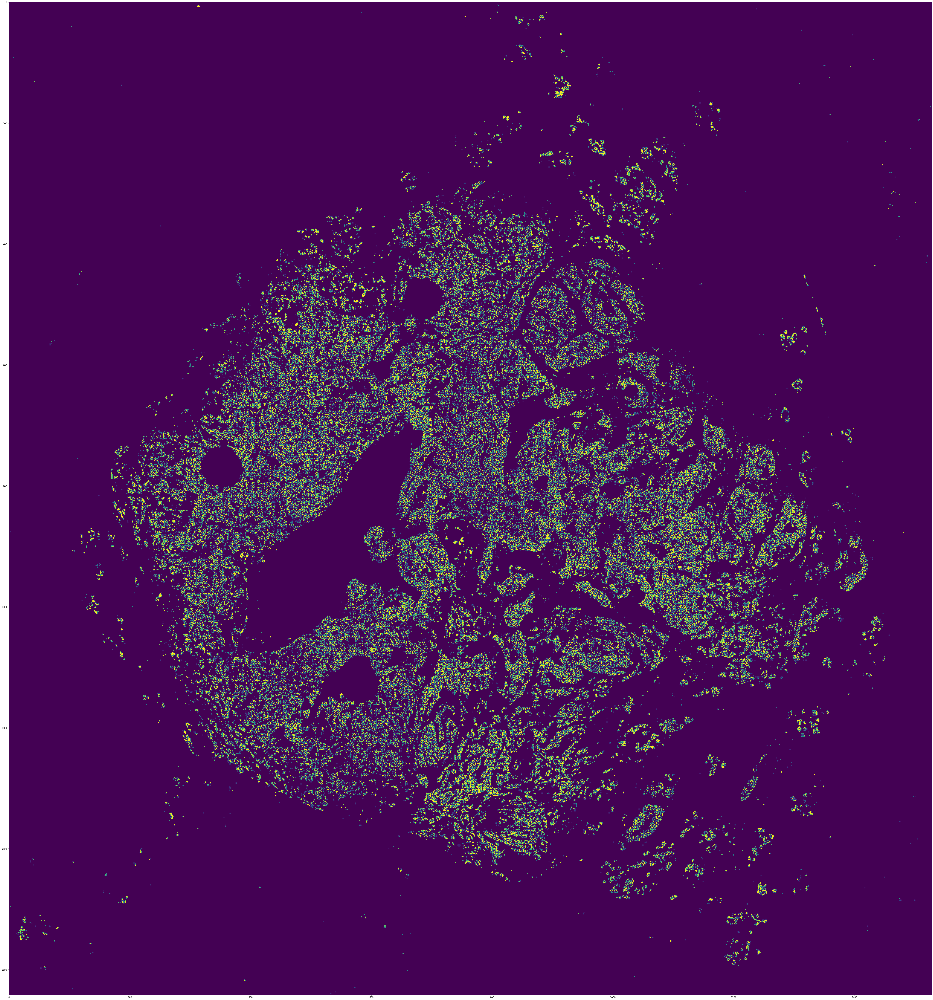

In [53]:
ph = h#[500:600, 150:250]
figsize = 1/20
plt.figure(figsize=(ph.shape[1] * figsize, ph.shape[0] * figsize))
# plt.contourf(ph[::-1, :])
plt.imshow(ph > 10)
plt.show()

In [107]:
def cartesian(x1, x2):
    return np.transpose([np.tile(x1, len(x2)), np.repeat(x2, len(x1))])

def _f(args):
    return np.exp(args[1].score_samples(args[0]))

def points2smooth(l, b, bandwidth=0.5, num_process=1):
    d = objects.metadata[b.image_id]['divide']
    corners = {'tly': b.corner_y * d, 'tlx': b.corner_x * d, 'bry': (b.corner_y + b.size_y) * d, 'brx':(b.corner_x + b.size_x) * d}
    s = scores[(scores.label == l) & (scores.image_id == b.image_id) &
               (scores.x >= corners['tlx']) & (scores.x <= corners['brx']) & 
               (scores.y >= corners['tly']) & (scores.y <= corners['bry'])].copy()
    
    s.x = s.x / resolution_divide
    s.y = s.y / resolution_divide
    # for res_div = 500, bandwidth 0.5 was ok 
    d = KernelDensity(kernel='gaussian', bandwidth=bandwidth, algorithm='ball_tree', leaf_size=20).fit(s[['y', 'x']])
    gy = np.arange(corners['tly'] / resolution_divide , corners['bry'] / resolution_divide)
    gx = np.arange(corners['tlx'] / resolution_divide , corners['brx'] / resolution_divide)
    grid = cartesian(gy, gx)
    if num_process < 2:
        m = _f((grid, d)).reshape((gx.shape[0], gy.shape[0])).T
    else:
        pool = Pool(num_process)
        part_size = int(grid.shape[0] / num_process) + 1
        g_parts = [(grid[i * part_size: (i + 1) * part_size, :], d) for i in range(num_process)]
        m = np.concatenate(pool.map(_f, g_parts)).reshape((gx.shape[0], gy.shape[0])).T
    return m / m.max()

In [108]:
m = points2smooth('model_tumor', objects.boxes.loc[0], bandwidth=2, num_process=8)

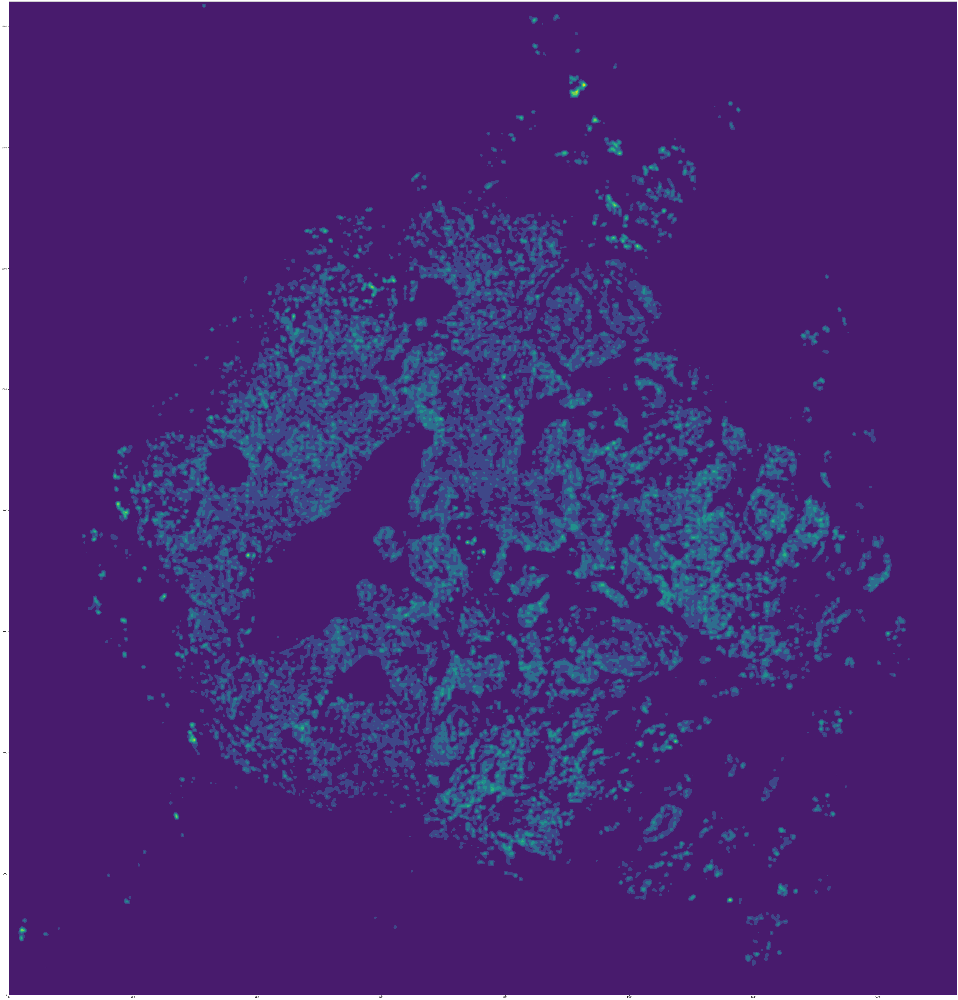

In [109]:
pm = m#[500:600, 150:250]# > 0.00001
figsize = 1/20
plt.figure(figsize=(pm.shape[1] * figsize, pm.shape[0] * figsize))
plt.contourf(pm[::-1, :])
# plt.imshow(pm)
plt.show()

In [122]:
# th for resolution divide 200, bandwidth 0.5 was 0.05 
# and for rd 50 bw 1.5 was 0.06
th = 0.06
contours = measure.find_contours(m, th, fully_connected='low', positive_orientation='high')
len(contours)

1554

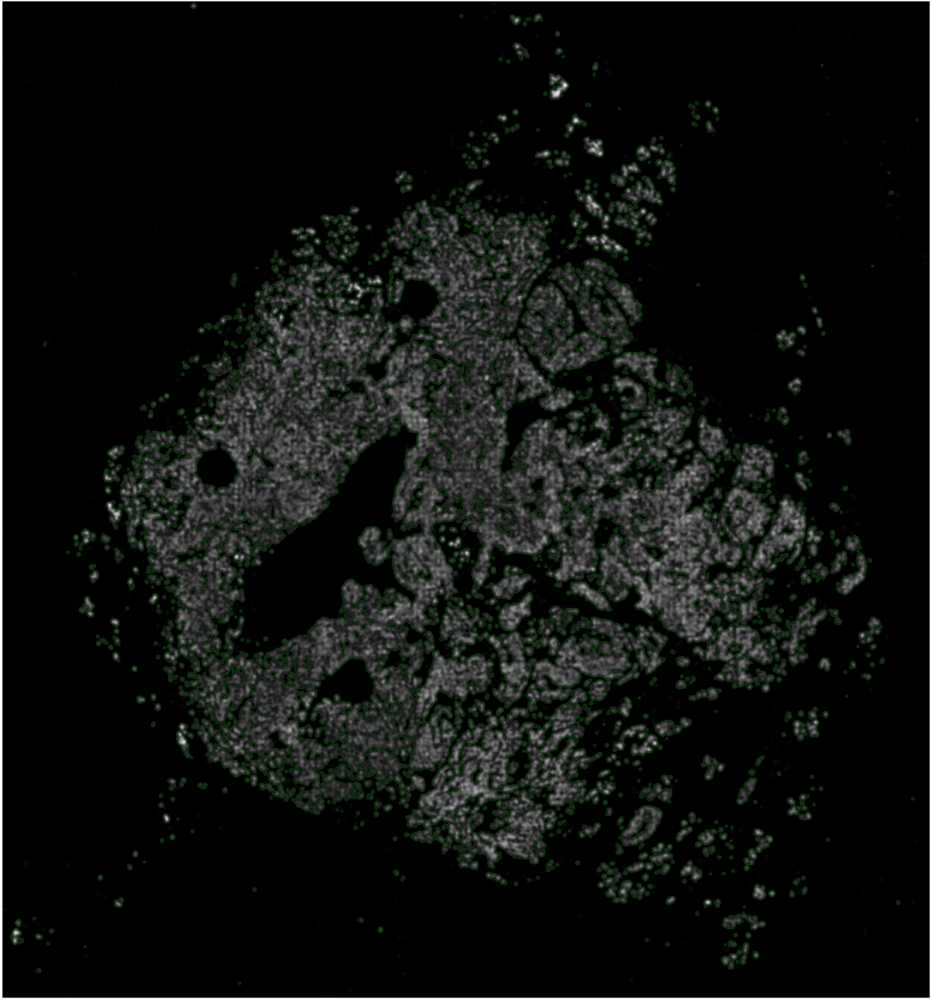

In [123]:
# Display the image and plot all contours found
fig, ax = plt.subplots(figsize=(pm.shape[1] * figsize, pm.shape[0] * figsize))
ax.imshow(pm, cmap=plt.cm.gray)
# ax.contourf(pm)

for contour in contours:
    ax.plot(contour[:, 1], contour[:, 0], linewidth=1.5, color='green')

ax.axis('image')
ax.set_xticks([])
ax.set_yticks([])
plt.show()

In [114]:
c_adjusted = [c * resolution_divide for c in contours]
MultiPolygon([Polygon(c) for c in c_adjusted])

In [124]:
_, m_thresh = cv2.threshold(m, th, 1, cv2.THRESH_BINARY)
m_thresh = cv2.convertScaleAbs(m_thresh)
cons, hiers = cv2.findContours(m_thresh, cv2.RETR_CCOMP, cv2.CHAIN_APPROX_SIMPLE)

In [125]:
# len([c for c in cons if c.shape[0] > 1])
# cons[2].shape
# len(cons), hiers.shape
# hiers
# [c * resolution_divide for c in cons]

In [126]:
def contours2multiploygon(cv2contours, cv2hierarchy, min_area=0.1):
    # now messy stuff to associate parent and child contours
    cnt_children = defaultdict(list)
    child_contours = set()
    assert cv2hierarchy.shape[0] == 1
    # http://docs.opencv.org/3.1.0/d9/d8b/tutorial_py_contours_hierarchy.html
    for idx, (_, _, _, parent_idx) in enumerate(cv2hierarchy[0]):
        if parent_idx != -1:
            child_contours.add(idx)
            cnt_children[parent_idx].append(cv2contours[idx])
    # create actual polygons filtering by area (removes artifacts)
    all_polygons = []
    for idx, cnt in enumerate(cv2contours):
        if idx not in child_contours and cv2.contourArea(cnt) >= min_area:
            assert cnt.shape[1] == 1
            if min_area > 0.:
                holes = [c[:, 0, :] for c in cnt_children[idx] if cv2.contourArea(c) >= min_area]
            else:
                holes = [c[:, 0, :] for c in cnt_children[idx]]
            poly = Polygon(shell=cnt[:, 0, :], holes=holes)
            all_polygons.append(poly)
    all_polygons = MultiPolygon(all_polygons)
    return all_polygons

In [127]:
mpoly = contours2multiploygon([c * resolution_divide for c in cons], hiers)
# valid_indexes = [c.shape[0] > 2 for c in cons]
# mpoly = contours2multiploygon([c for c in cons if c.shape[0] > 2], hiers[:, [c.shape[0] > 2 for c in cons], :])

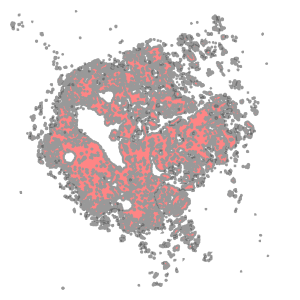

In [128]:
mpoly

In [129]:
# without shift was [[[[62000.0, 78400.0], [62000.0, 78800.0]
# with shift became [[[[69414.0, 101937.0], [69414.0, 102337.0]
b = objects.boxes.loc[0]
mpoly_box_offest = translate(mpoly, xoff=b.corner_x * objects.metadata[b.image_id]['divide'], yoff=b.corner_y * objects.metadata[b.image_id]['divide'])

In [130]:
exjson = str({k:v for k,v in geopd.GeoSeries([mpoly_box_offest]).__geo_interface__['features'][0].items() if k in ['type', 'properties', 'geometry']})
exjson = exjson.replace(',)', ')').replace('(', '[').replace(')', ']').replace('\'', '\"')

In [131]:
with open('T12_95093_A1_HE__model_scores_5class_r3_mu__model_tumor.json', 'w') as f:
    f.write(exjson)

In [39]:
schema = {
    'geometry': 'MultiPolygon',
    'properties': {'id': 'int'},
}

with fiona.open('T12_95093_A1_HE__model_scores_5class_r3_mu__model_tumor.shp', 'w', 'ESRI Shapefile', schema) as c:
    ## If there are multiple geometries, put the "for" loop here
    c.write({'geometry': mapping(mpoly), 'properties': {'id': 1} })